# Image classification

### Modeling Procedure

1. Examine and understand data
2. Build an input pipeline
3. Build the model
4. Train the model
5. Test the model
6. Improve the model and repeat the process

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

## Download and explore the dataset

In [3]:
import pathlib

data_dir = pathlib.Path(r"C:\Users\raunaq habib\Desktop\Mohsina Python\image processing\classes")

# Use the data_dir variable for further processing

In [4]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

403


In [5]:
subdirectories = list(data_dir.glob('*/'))

print(subdirectories)

[WindowsPath('C:/Users/raunaq habib/Desktop/Mohsina Python/image processing/classes/city'), WindowsPath('C:/Users/raunaq habib/Desktop/Mohsina Python/image processing/classes/forest'), WindowsPath('C:/Users/raunaq habib/Desktop/Mohsina Python/image processing/classes/mountains'), WindowsPath('C:/Users/raunaq habib/Desktop/Mohsina Python/image processing/classes/sea')]


In [6]:
for subdirectory in subdirectories:
    image_files = list(subdirectory.glob('*.jpg'))  # Assuming the images are in JPEG format
    
    if len(image_files) > 0:
        image_path = image_files[0]
        image = PIL.Image.open(str(image_path))
        image.show()
    else:
        print(f"No images found in subdirectory: {subdirectory}")

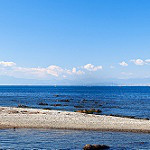

In [7]:
#Some sea image
sea_images = list(data_dir.glob('sea/*'))
PIL.Image.open(str(sea_images[0]))

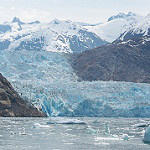

In [8]:
# Some mountain image
mountain_images = list(data_dir.glob('mountains/*'))
PIL.Image.open(str(mountain_images[0]))

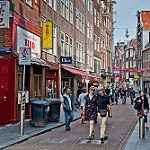

In [9]:
# Some city image
city_images = list(data_dir.glob('city/*'))
PIL.Image.open(str(city_images[0]))

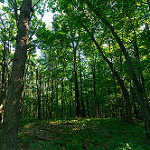

In [10]:
# Some forest image
forest_images = list(data_dir.glob('forest/*'))
PIL.Image.open(str(forest_images[0]))

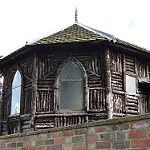

In [11]:
PIL.Image.open(str(city_images[1]))

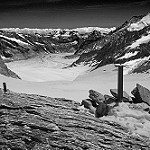

In [12]:
PIL.Image.open(str(mountain_images[1]))

## Load data using a Keras utility

### Create a dataset

Define some parameters for the loader:

In [13]:
batch_size = 32
img_height = 180
img_width = 180

Using a validation split for this model. Used 80% of the images for training and 20% for validation.

In [14]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 403 files belonging to 4 classes.
Using 323 files for training.


In [15]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 403 files belonging to 4 classes.
Using 80 files for validation.


Found the class names in the `class_names` attribute on these datasets. These correspond to the directory names in alphabetical order.

In [16]:
class_names = train_ds.class_names
print(class_names)

['city', 'forest', 'mountains', 'sea']


## Visualize the data
The first nine images from the training dataset:

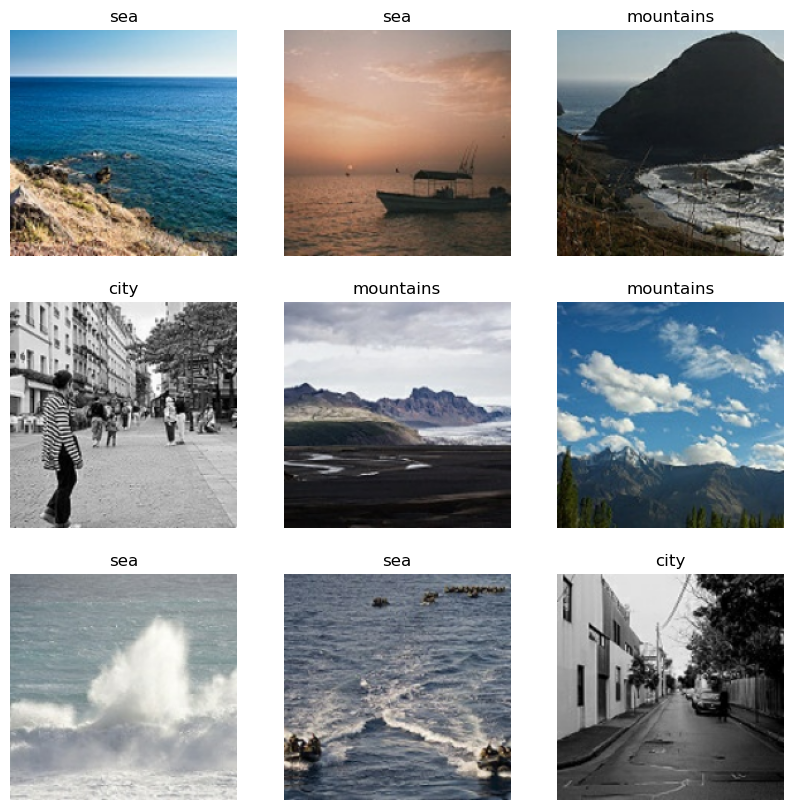

In [17]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

Manually iterating over the dataset and retrieve batches of images:

In [18]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


## Configure the dataset for performance

Used buffered prefetching, to yield data from disk without having I/O become blocking. Methods used while loading the data:

- `Dataset.cache` keeps the images in memory after they're loaded off disk during the first epoch. This will ensure the dataset does not become a bottleneck while training your model. If your dataset is too large to fit into memory, you can also use this method to create a performant on-disk cache.
- `Dataset.prefetch` overlaps data preprocessing and model execution while training.

In [19]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

## Standardize the data

Standardized from [0, 255] to [0, 1] range to avoid any issues in the neural network

In [20]:
normalization_layer = layers.Rescaling(1./255)

In [21]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 0.9999184


## A basic Keras model

### Create the model

The Keras Sequential model consists of three convolution blocks (`tf.keras.layers.Conv2D`) with a max pooling layer (`tf.keras.layers.MaxPooling2D`) in each of them. There's a fully-connected layer (`tf.keras.layers.Dense`) with 128 units on top of it that is activated by a ReLU activation function (`'relu'`). This model has not been tuned for high accuracy.

In [22]:
num_classes = len(class_names)

model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

### Compile the model
Used Adam optimizer and Sparse Category Cross Entropy Loss.
To view training and validation accuracy for each training epoch.

In [23]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

### Model summary

In [24]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 45, 45, 64)        1

### Train the model

Trained the model for 10 epochs 

In [25]:
epochs=10
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/10
11/11 [==============================] - 15s 1s/step - loss: 1.6809 - accuracy: 0.2910 - val_loss: 1.3878 - val_accuracy: 0.2625
Epoch 2/10
11/11 [==============================] - 7s 653ms/step - loss: 1.2462 - accuracy: 0.3963 - val_loss: 1.2391 - val_accuracy: 0.4500
Epoch 3/10
11/11 [==============================] - 7s 652ms/step - loss: 1.0414 - accuracy: 0.5573 - val_loss: 1.5256 - val_accuracy: 0.3250
Epoch 4/10
11/11 [==============================] - 7s 683ms/step - loss: 1.0357 - accuracy: 0.4582 - val_loss: 1.1828 - val_accuracy: 0.4750
Epoch 5/10
11/11 [==============================] - 7s 661ms/step - loss: 0.8968 - accuracy: 0.5851 - val_loss: 0.9676 - val_accuracy: 0.6000
Epoch 6/10
11/11 [==============================] - 7s 654ms/step - loss: 0.7541 - accuracy: 0.6966 - val_loss: 0.9861 - val_accuracy: 0.6000
Epoch 7/10
11/11 [==============================] - 7s 675ms/step - loss: 0.6591 - accuracy: 0.7183 - val_loss: 1.0113 - val_accuracy: 0.4875
Epoch 8/

## Visualize training results

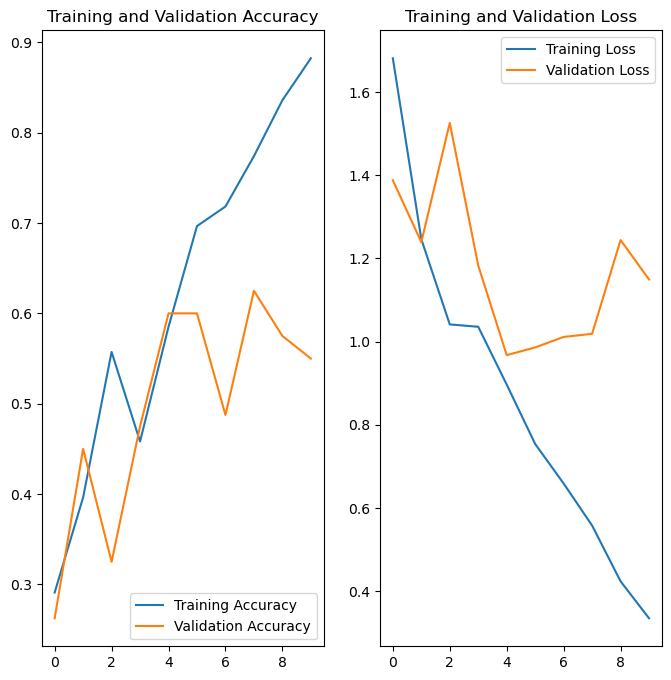

In [26]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

The plots show that training accuracy and validation accuracy are off by large margins.

This means that there has been overfitting of data.

## Overfitting

Used *data augmentation* and add *dropout* to our model to deal with overfitting.

## Data augmentation

Overfitting generally occurs when there are a small number of training examples. Data augmentation takes the approach of generating additional training data from your existing examples by augmenting them using random transformations that yield believable-looking images. This helps expose the model to more aspects of the data and generalize better.

In [27]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(img_height,
                                  img_width,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)

Visualize a few augmented examples by applying data augmentation to the same image several times:

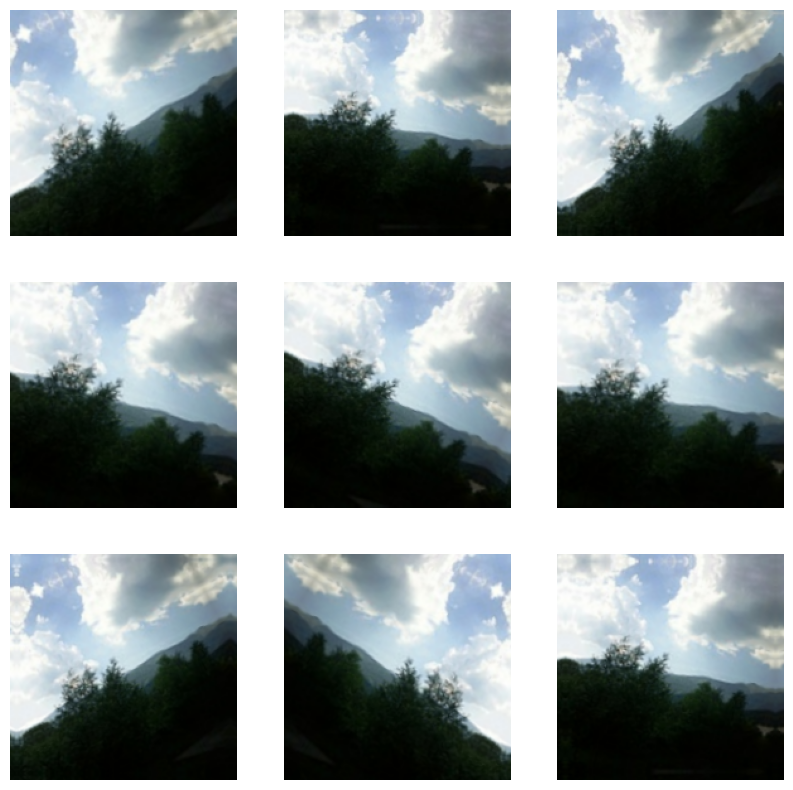

In [28]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

You will add data augmentation to your model before training in the next step.

## Dropout

Another technique to reduce overfitting is to introduce dropout regularization to the network.

When you apply dropout to a layer, it randomly drops out (by setting the activation to zero) a number of output units from the layer during the training process. 

In [29]:
model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, name="outputs")
])

## Compile and train the model

In [30]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [31]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 180, 180, 3)       0         
                                                                 
 rescaling_2 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 90, 90, 16)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                  

In [32]:
epochs = 15
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/15
11/11 [==============================] - 13s 907ms/step - loss: 1.5764 - accuracy: 0.2972 - val_loss: 1.3476 - val_accuracy: 0.2750
Epoch 2/15
11/11 [==============================] - 9s 783ms/step - loss: 1.2609 - accuracy: 0.3684 - val_loss: 1.1399 - val_accuracy: 0.5125
Epoch 3/15
11/11 [==============================] - 9s 786ms/step - loss: 1.2232 - accuracy: 0.3870 - val_loss: 1.1037 - val_accuracy: 0.4875
Epoch 4/15
11/11 [==============================] - 9s 870ms/step - loss: 1.0289 - accuracy: 0.5077 - val_loss: 0.9315 - val_accuracy: 0.5625
Epoch 5/15
11/11 [==============================] - 9s 780ms/step - loss: 0.9773 - accuracy: 0.5387 - val_loss: 0.8870 - val_accuracy: 0.6500
Epoch 6/15
11/11 [==============================] - 9s 773ms/step - loss: 0.8840 - accuracy: 0.5975 - val_loss: 0.9104 - val_accuracy: 0.6500
Epoch 7/15
11/11 [==============================] - 8s 768ms/step - loss: 0.9107 - accuracy: 0.5944 - val_loss: 1.0023 - val_accuracy: 0.6000
Epoch

## Visualize training results

After applying data augmentation and `tf.keras.layers.Dropout`, there is less overfitting than before, and training and validation accuracy are closer aligned:

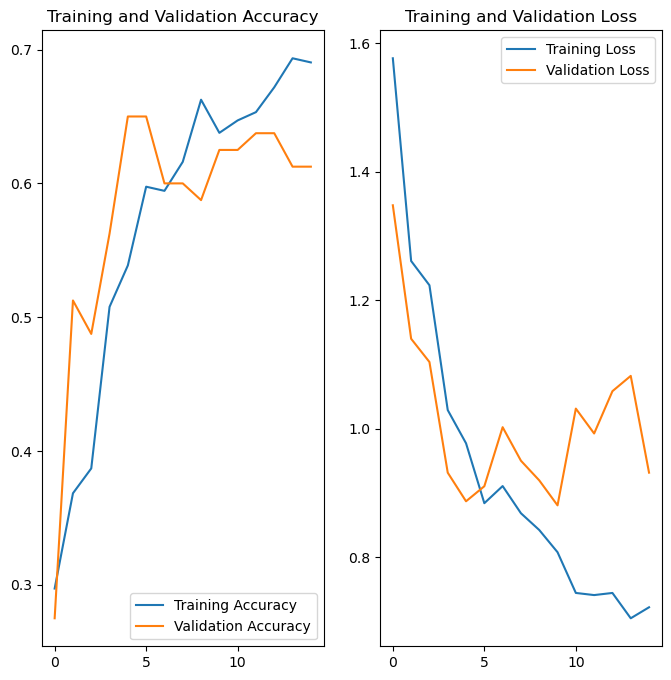

In [33]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

## Predict on new data

Used model to classify an image that wasn't included in the training or validation sets.

In [34]:
#some random image not from train or test data
new_data = pathlib.Path("test.jpg")

img = tf.keras.utils.load_img(
    new_data, target_size=(img_height, img_width)
)
img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

1/1 [==============================] - 0s 462ms/step
This image most likely belongs to city with a 100.00 percent confidence.


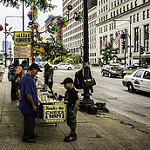

In [35]:
PIL.Image.open(str(new_data)) #IT IS A CITY IMAGE!

1/1 [==============================] - 0s 224ms/step


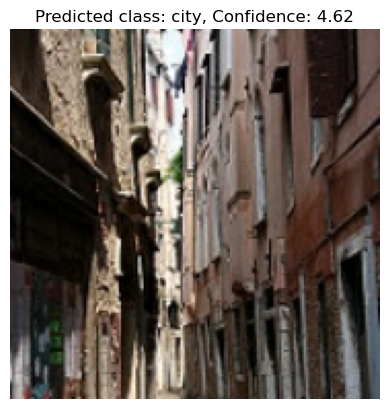

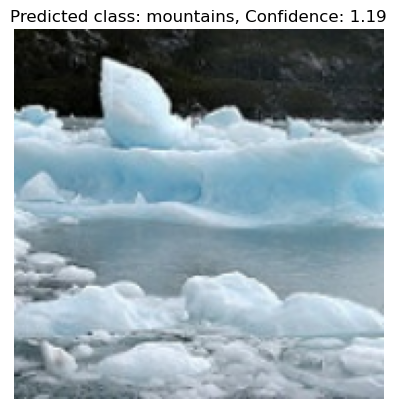

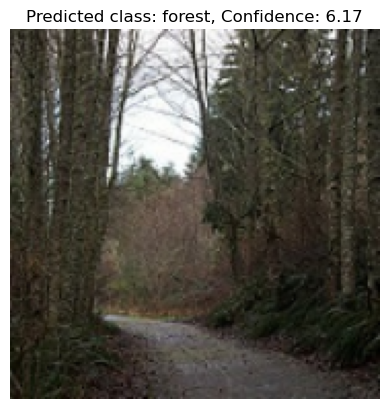

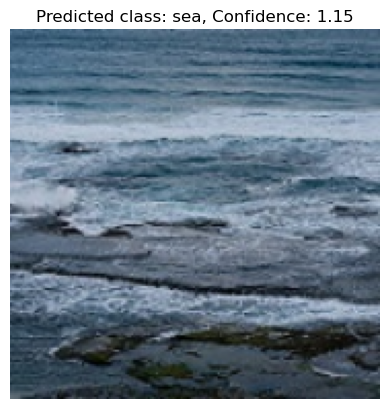

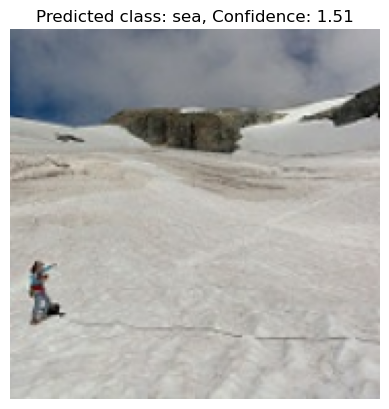

...

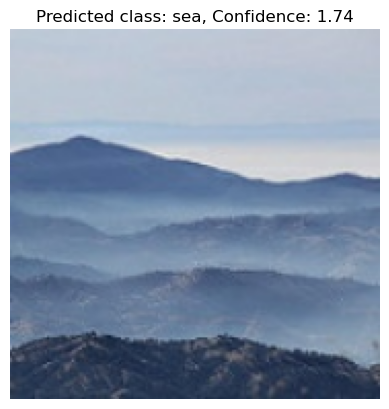

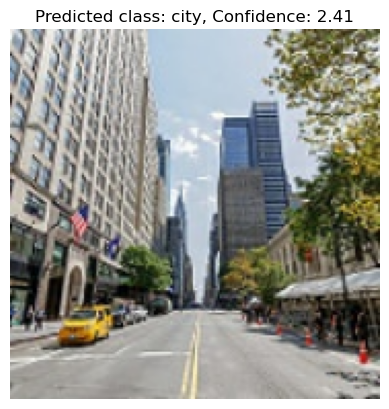

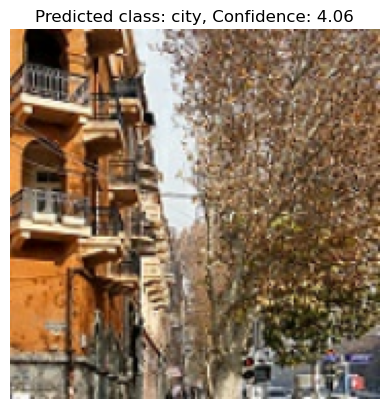

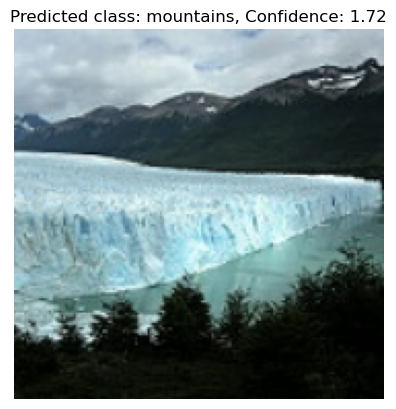

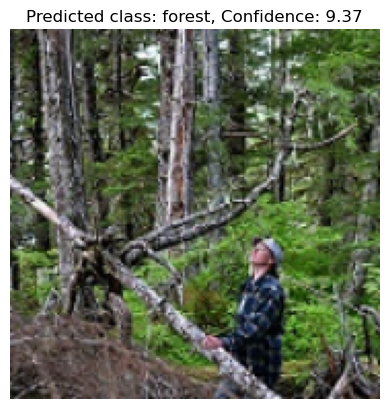

1/1 [==============================] - 0s 223ms/step


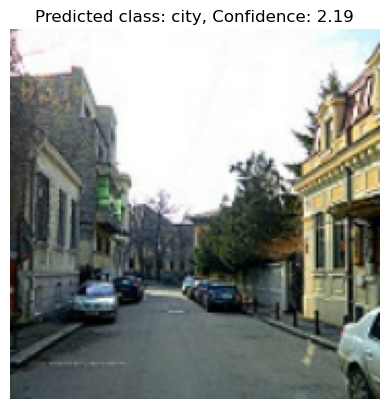

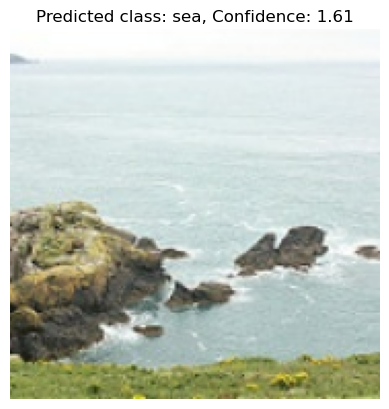

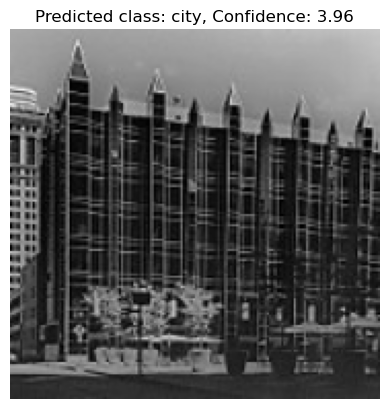

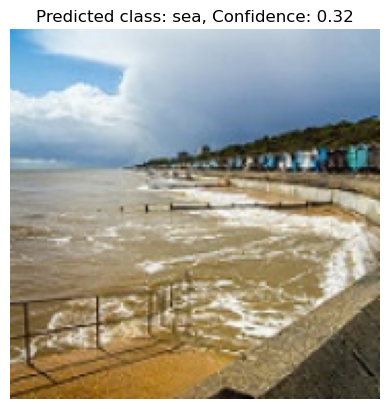

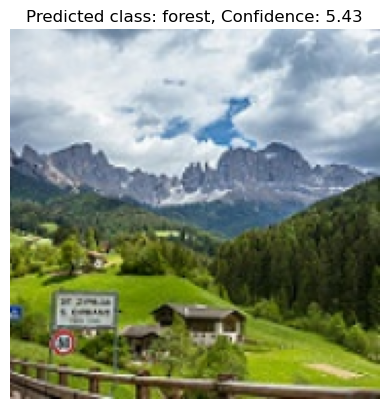

...

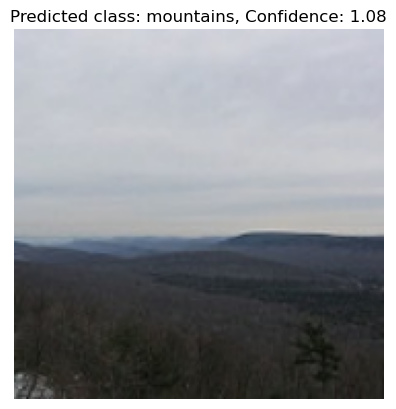

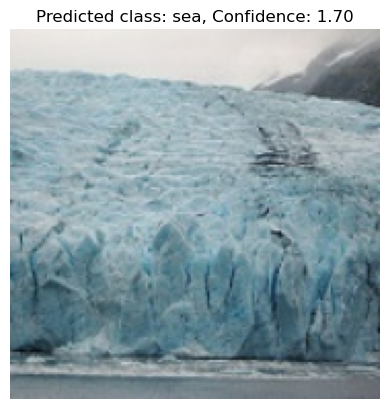

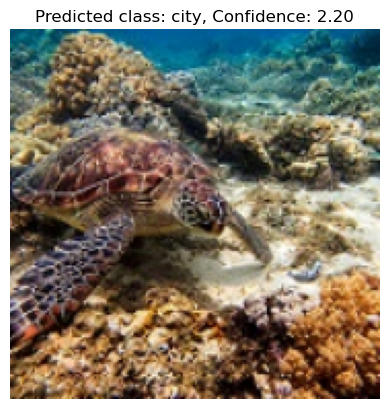

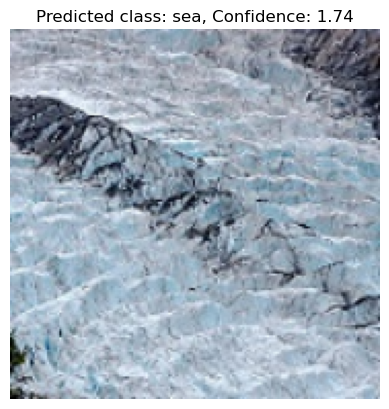

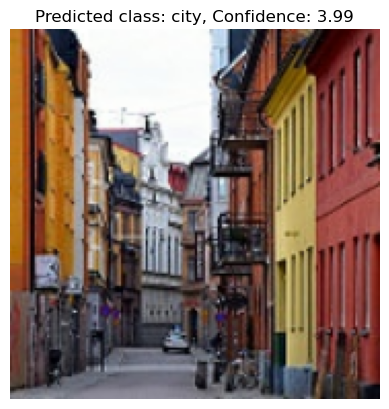

1/1 [==============================] - 0s 127ms/step


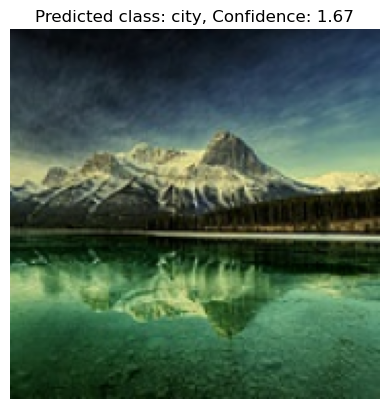

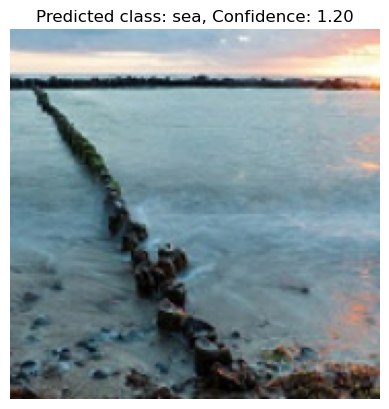

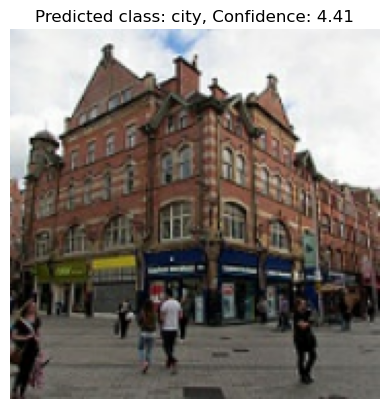

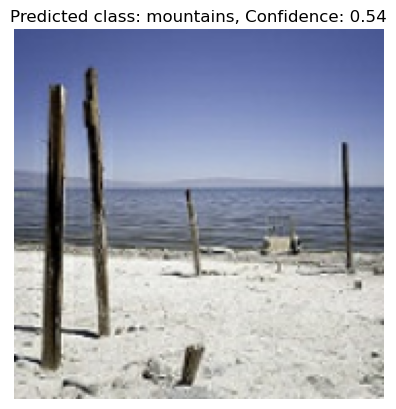

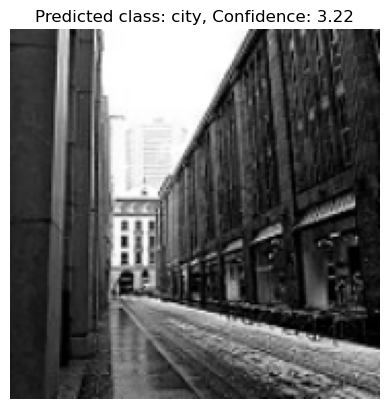

...

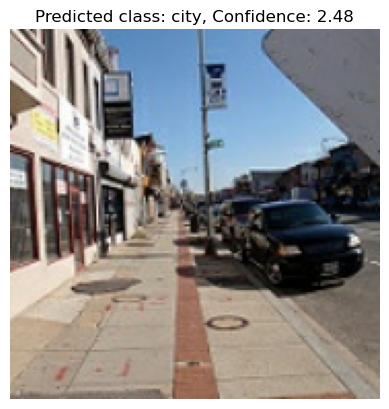

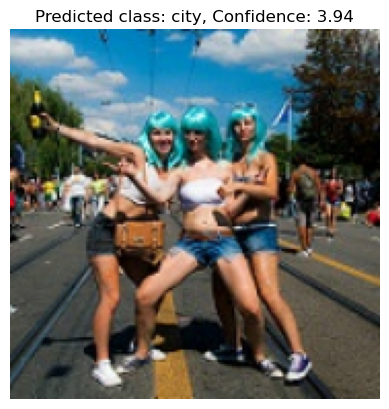

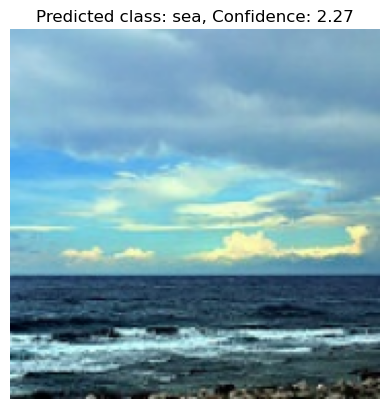

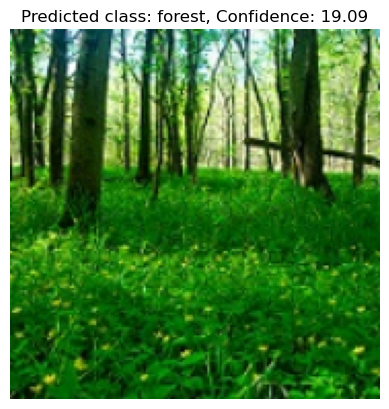

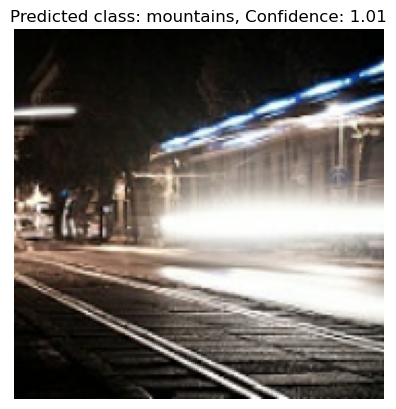

In [41]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

for images, labels in val_ds:
    predictions = model.predict(images)
    predicted_classes = np.argmax(predictions, axis=1)

    for i in range(len(predicted_classes)):
        predicted_class = class_names[predicted_classes[i]]
        confidence = predictions[i][predicted_classes[i]]

        # Access the image and convert it to PIL Image
        image = Image.fromarray(np.uint8(images[i]))
        
        # Display the image along with its prediction
        plt.imshow(image)
        plt.title(f"Predicted class: {predicted_class}, Confidence: {confidence:.2f}")
        plt.axis('off')
        plt.show()

1/1 [==============================] - 0s 147ms/step


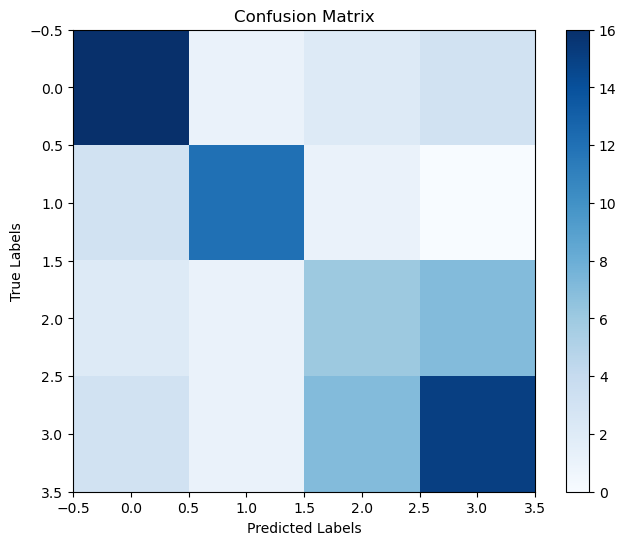

In [39]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

true_labels = []
predicted_labels = []

for images, labels in val_ds:
    predictions = model.predict(images)
    predicted_classes = np.argmax(predictions, axis=1)
    
    true_labels.extend(labels.numpy())
    predicted_labels.extend(predicted_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Compute confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()


#### Classification Report 

- Precision
- Recall
- F1-Score
- Support

In [44]:
#Classification report 

from sklearn.metrics import classification_report

# Generate the classification report
classification_rep = classification_report(true_labels, predicted_labels)
print(classification_rep)

              precision    recall  f1-score   support

           0       0.67      0.73      0.70        22
           1       0.80      0.75      0.77        16
           2       0.38      0.38      0.38        16
           3       0.60      0.58      0.59        26

    accuracy                           0.61        80
   macro avg       0.61      0.61      0.61        80
weighted avg       0.61      0.61      0.61        80



#### AUC-ROC Curve 

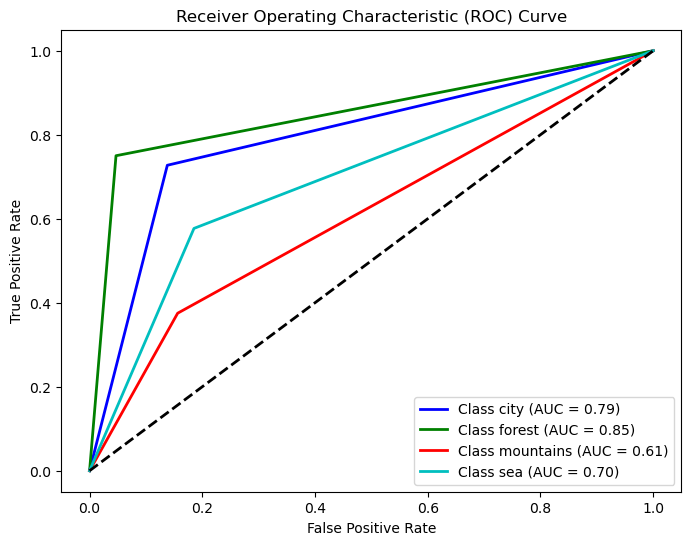

In [45]:
# Calculating the AUC-ROC Curve for true_labels and predicted_labels

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Convert true labels and predicted labels to one-hot encoded format
true_labels_one_hot = tf.one_hot(true_labels, num_classes)
predicted_labels_one_hot = tf.one_hot(predicted_labels, num_classes)

# Get the number of classes
num_classes = len(class_names)

# Compute the false positive rate (FPR), true positive rate (TPR), and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(num_classes):
    fpr[i], tpr[i], _ = roc_curve(true_labels_one_hot[:, i], predicted_labels_one_hot[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC curve for each class
plt.figure(figsize=(8, 6))
colors = ['b', 'g', 'r', 'c']
for i in range(num_classes):
    plt.plot(fpr[i], tpr[i], color=colors[i], lw=2, label='Class {} (AUC = {:.2f})'.format(class_names[i], roc_auc[i]))

# Plot the random guess line
plt.plot([0, 1], [0, 1], color='k', lw=2, linestyle='--')

# Set plot labels and title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')

# Show the plot
plt.show()


#### Calculating KS and Gini for true_labels and predicted_labels 

In [46]:
def calculate_gini(actual, predicted):
    # Sort the predicted labels and actual labels based on the predicted values
    sorted_labels = [label for _, label in sorted(zip(predicted, actual), key=lambda pair: pair[0])]
    n = len(sorted_labels)
    
    # Calculate the cumulative proportions of positive samples
    cumulative_positives = np.cumsum(sorted_labels)
    cumulative_proportions = np.arange(1, n+1) / n
    
    # Calculate the Gini coefficient
    gini = np.sum(cumulative_positives) / (np.sum(sorted_labels) * n) - np.sum(cumulative_proportions) / n
    
    return gini

# Calculate Gini coefficient 
gini_coefficient = calculate_gini(true_labels, predicted_labels)


print("Gini coefficient:", gini_coefficient)

Gini coefficient: -0.12857142857142856


In [47]:
def calculate_ks(actual, predicted):
    # Sort the predicted labels and actual labels based on the predicted values
    sorted_labels = [label for _, label in sorted(zip(predicted, actual), key=lambda pair: pair[0])]
    n = len(sorted_labels)
    
    # Calculate the cumulative proportions of positive and negative samples
    cumulative_positives = np.cumsum(sorted_labels)
    cumulative_negatives = np.arange(1, n+1) - cumulative_positives
    
    # Calculate the KS statistic
    ks = np.max(np.abs(cumulative_positives / np.sum(sorted_labels) - cumulative_negatives / (n - np.sum(sorted_labels))))
    
    return ks

# Calculate KS statistic
ks_statistic = calculate_ks(true_labels, predicted_labels)

print("KS statistic:", ks_statistic)

KS statistic: 0.404071773636991
